## Welcome to the LCMAP Demo

This is an example of how to use the LCMAP cube from an ipython notebook.

In [43]:
import lcmap.db.tile as tile
from lcmap.ingest.util import snap, to_lon_lat, to_epsg_5070
from lcmap.db.util import as_array

### Some Preliminaries

We store data in tiles. Each tile is uniformly sized. You need to know the convention for finding the tile (an upper-left pixel in the projection system coordinate) for an arbitrary point.

It would be nice to be able to take a longitude and lattitude and get the grid projection coordinates, snapped to a grid-snapped tile x- and y- coordinate:

In [78]:
# eventually, these parameters will be stored in another table
tile_size  = 256
pixel_size = 30
offset_y   = -20
grid       = tile_size*pixel_size

# ...but for now, you need to specify them
x, y = snap(*to_epsg_5070(-120.55, 48.24), offset_y=-20, tile_size=256, pixel_x=30, pixel_y=30)
snap(x, y, tile_size=256, offset_y=-20)

(-1820160, 3041260)

## Simple Example

Let's get one year of data for the pixel we located in the cell above and list the scenes that it came from...

In [79]:
layer = "sr_band4"
start = "2013-01-01"
stop  = "2015-01-01"
rows  = tile.find(x, y, layer, start, stop)
len(rows)

216

## Multi-Scene, Multi-Layer, Multi-Tile, Timeseries Data
We will build a 432 color composite using several tiles. Obviously, you shouldn't need to do all this querying yourself, it should be possible to get all this data with a query for each band.

In [77]:
start = "2013-01-01"
stop  = "2014-01-01"
reds   = [tile.find(x+grid*i, y+grid*0, "sr_band4", start, stop) for i in range(0,4) ]
greens = [tile.find(x+grid*i, y+grid*0, "sr_band3", start, stop) for i in range(0,4) ]
blues  = [tile.find(x+grid*i, y+grid*0, "sr_band2", start, stop) for i in range(0,4) ]

In [66]:
from lcmap.db.util import as_array
import numpy as np

i = 1
rs = np.hstack([as_array(r[i]) for r in reds[0:4]])
gs = np.hstack([as_array(g[i]) for g in greens[0:4]])
bs = np.hstack([as_array(b[i]) for b in blues[0:4]])

IndexError: list index out of range

/data/local/anaconda3/envs/py34/lib/python3.4/site-packages/skimage/util/dtype.py:111: UserWarning: Possible precision loss when converting from float64 to uint16
  "%s to %s" % (dtypeobj_in, dtypeobj))


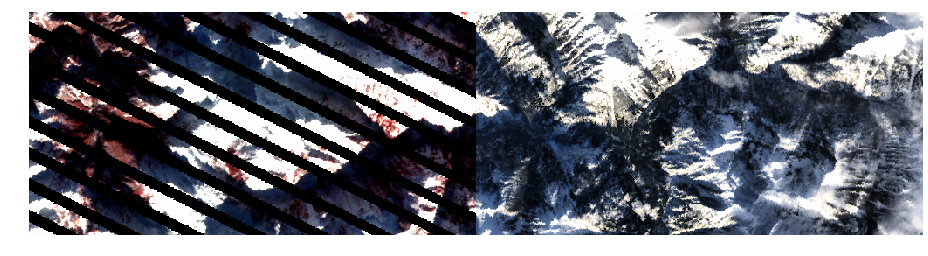

In [61]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.colors as mc
import matplotlib.cm as cm
import skimage.exposure as ex
n = mc.Normalize(0.0, 1.0, clip=True)

rgb = np.dstack((rs,gs,bs))
rgb_ah = ex.equalize_adapthist(n(rgb), clip_limit=0.01)
fig = plt.figure(figsize=(16,4))
plt.axis('off')
plt.imshow(rgb_ah, interpolation='nearest')

In [5]:
import numpy as np
import numpy.ma as ma
import pandas as pd


def as_array(row):
    """Convert raw data into a shaped, masked, and scaled array.
    """
    arr = np.ma.frombuffer(row.data, dtype=row.data_type)
    arr = np.resize(arr, row.data_shape)
    np.ma.masked_equal(arr, row.data_fill)
    np.ma.masked_outside(arr, *row.data_range)
    arr = arr * row.data_scale
    return arr


def meld(cube, grid=30*256, size=256):

    # The "cube" of data is a list of query result rows. So it isn't exactly a cube yet.
    # Each result is a pair: the first element is True/False indicating if the query
    # was successful. The second element is a list of rows. Each row is tile at a point
    # in time. So conceptually a results is:
    #
    # [ True, [tile1, tile2, tile3, ... ]]
    #
    # This unpacks all of the tiles in a result into a single list of rows.
    #
    rows = [row for result in cube if result[0] and len(result[1]) > 0 for row in result[1]]

    # Now that we have just a bunch of rows, we use the as_array function to take make
    # an array out of the blob that is shaped, scaled, and masked (using the valid range
    # and fill values associated with the row).
    tiles = []
    for row in rows:
        tile = row._asdict()
        tile['data'] = as_array(row)
        tiles.append(tile)

        
    # Each row becomes a Pandas dateframe (but why?)
    df_in = pd.DataFrame(tiles)
    if df_in.empty:
        return

    # Get the maximum extents -- 
    y_min, y_max = df_in.y.min(), df_in.y.max()
    x_min, x_max = df_in.x.min(), df_in.x.max()
    ys = range(y_max, y_min, -grid)
    xs = range(x_min, x_max, grid)

    # get each of the unique gropus for the resulting dataframe
    grouped = [{'acquired': key[0], 'layer': key[1]} for key, group in df_in.groupby(['acquired', 'layer'])]

    # iterate over the groups and accumulate the result
    result = []
    for group in grouped:

        # select all of the source rows for the group
        source = df_in[(df_in.acquired == group['acquired']) & (df_in.layer == group['layer'])]

        # save the data to the group
        group['data'] = _merge(source, ys, xs, grid, size)

        # append the group to the result
        result.append(group)

    # create a dataframe with the results so it's easier to select a portion of the data
    df = pd.DataFrame(result)
    return df.set_index(['acquired', 'layer'])


def _merge(source, ys, xs, grid, size):
    """
    Take in all of the data for a single acquisition date and layer and stacke them horizontally
    and vertically into a single array.  For any missing chunks, fill as NaN.
    """
    # create a filler to use in place of missing data
    gap = np.empty([size, size])
    gap.fill(np.nan)

    # index the data frame for easier searching
    df = source.set_index(['y', 'x'])

    y_data = []
    for y in ys:
        x_data = []
        for x in xs:
            x_chunk = gap if (y, x) not in df.index else df.ix[y, x]['data']
            x_data.append(x_chunk)

        if len(x_data) > 0:
            y_data.append(np.hstack(x_data))
        else:
            # fill the entire y if there is no x data
            y_data.append(np.hstack([gap] * len(xs)))

    return np.vstack(y_data)

## Multi-Scene with find_area (KI)

In [6]:
# lon1, lat1 = -122.824, 48.9158
# lon2, lat2 = -122.067, 48.7477
# x1, y1 = snap(*to_epsg_5070(lon1, lat1), offset_y=10)
# x2, y2 = snap(*to_epsg_5070(lon2, lat2), offset_y=10)

x1, y1 = x, y
x2, y2 = (x1 + 256*30*3), y1 - (256*30*3)
layers = "sr_band4"
t1, t2 = "2015-01-01", "2016-01-01"
cube = tile.find_area(x1, y1, x2, y2, layers, t1, t2, grid=256*30)

### Meld the cube into something easier to use (KI)

In [7]:
df = meld(cube)
c = np.array(cube)
list(map(len,c[:,1]))

[51, 42, 42, 51, 51, 51, 51, 51, 51]

In [ ]:
### Show an image for each time slice (KI)

/data/local/anaconda3/envs/py34/lib/python3.4/site-packages/matplotlib/pyplot.py:424: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


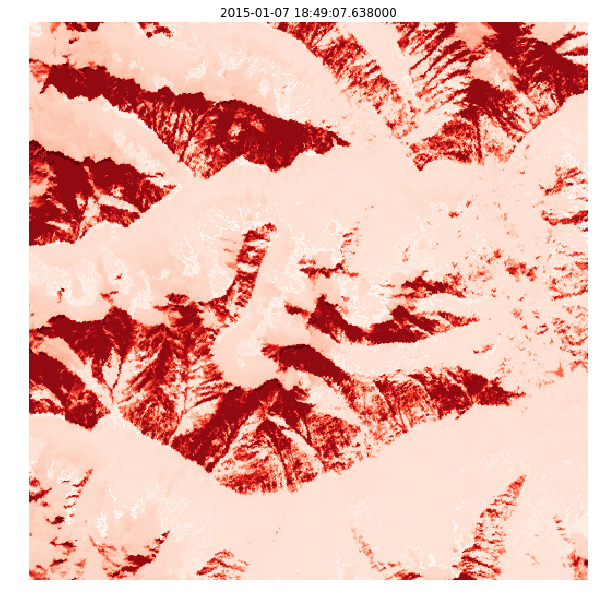

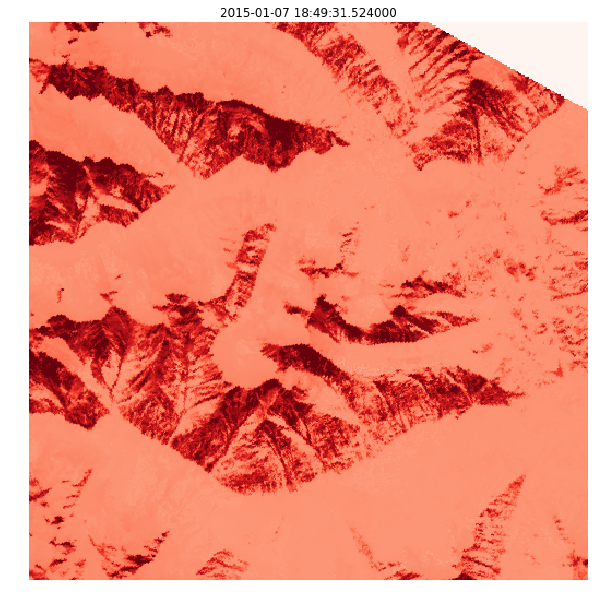

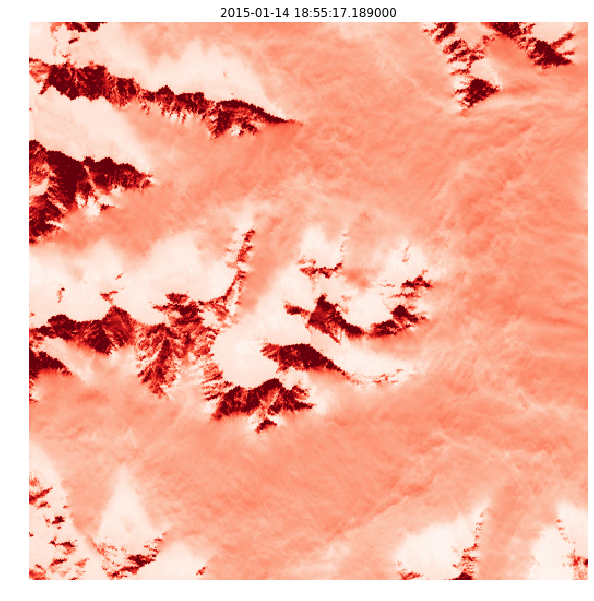

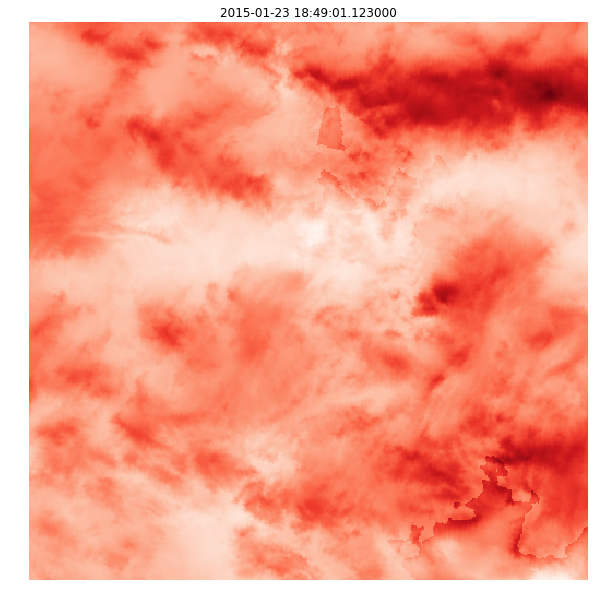

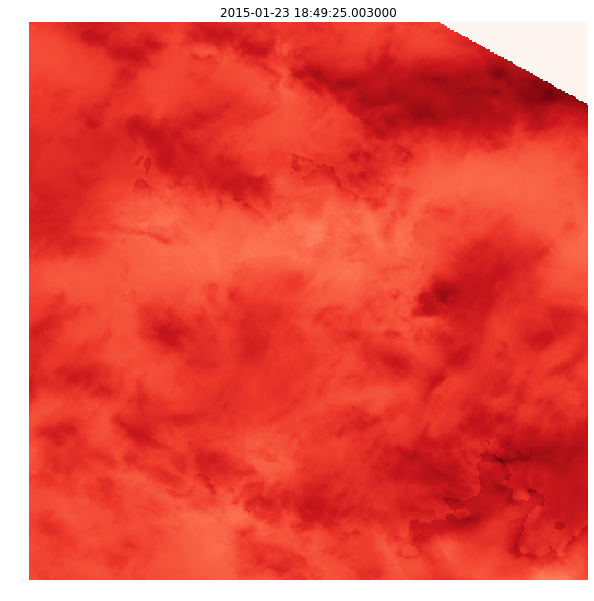

...

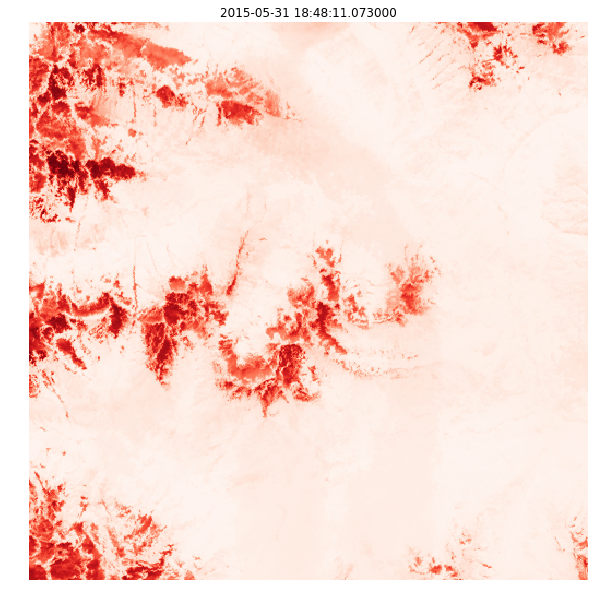

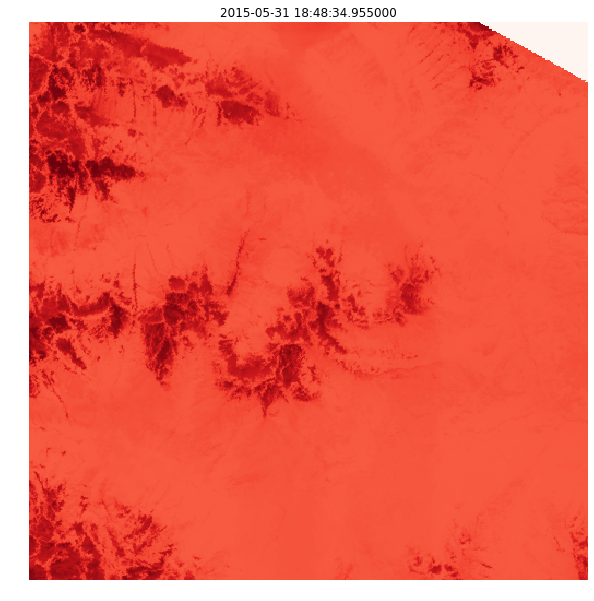

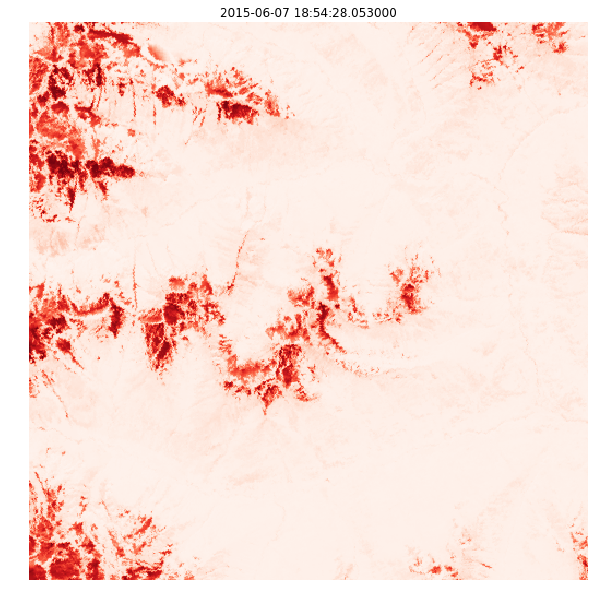

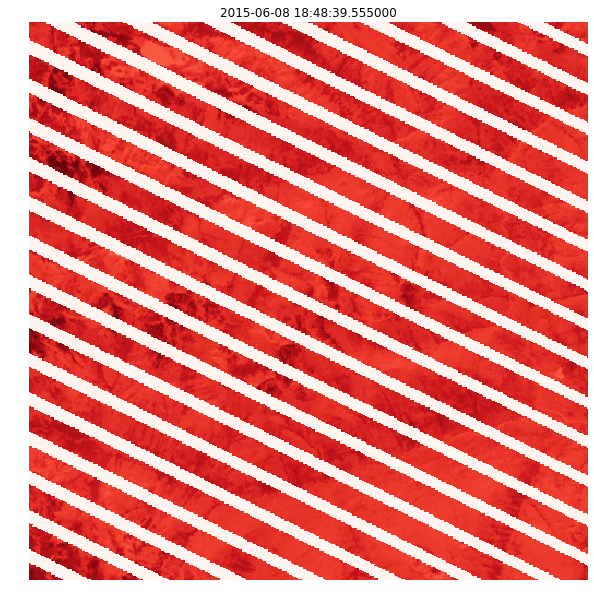

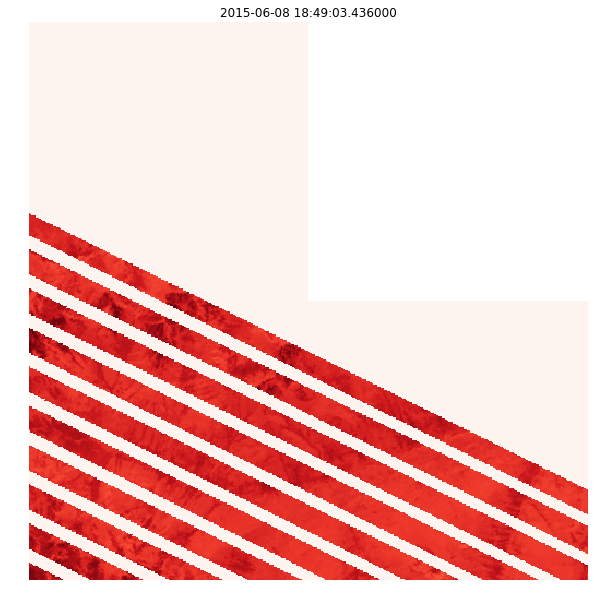

In [10]:
if df is not None:
    # loop through and generate an image for each acquisition date
    for t in df.index.get_level_values('acquired').unique():
        fig = plt.figure(figsize=(10,10))
        r_img = df.loc[t, 'sr_band4']['data']
        # g_img = df.loc[t, 'sr_band3']['data']
        # b_img = df.loc[t, 'sr_band2']['data']

        # rgb = np.dstack((r_img, g_img, b_img))
        plt.axis('off')
        plt.title(t)
        plt.imshow(r_img, interpolation='nearest', cmap=cm.Reds)